# Using OpenCV for Counting Stars
This notebook employs the OpenCV library,```cv2```, to process the images given, and thereafter, count the number of pixels above a certain threshold as stars (using a function from NumPy).

![](https://content.instructables.com/FFX/H4DJ/KAL2VCAR/FFXH4DJKAL2VCAR.png?auto=webp&fit=bounds&frame=1&width=1024)

> **NOT** our work. All the credit goes to [Daniel Hingston](https://www.instructables.com/Star-Recognition-Using-Computer-Vision-OpenCV/).

In [2]:
# these are the main libraries, ...
# the cell below is only there for the published report
import numpy as np
import matplotlib.pyplot as plt
from astropy.nddata import Cutout2D
from astropy import units
from astropy.io import fits
import glob
from astropy.visualization import astropy_mpl_style
from astropy.visualization import simple_norm
from astropy.utils.data import download_file
#from matplotlib.colors import *
from astropy.stats import sigma_clipped_stats
from skimage.filters import median
from skimage.measure import label, regionprops

# Libraries
The main library used was `cv2`, since the approach taken with `skimage` did not result in desirable outcomes.

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import median
from skimage.measure import label, regionprops
import cv2

In [4]:
# image = fits.getdata("carina_nircam.fits")
# plt.imshow(image)
# print(f"the type of image is {type(image)}")

Here, the plan was to:
1. Convert the image to grayscale for better processing
2. Apply a median filter to reduce noise
3. Use binary and the Otsu thresholds to create a black & white image
4. Detect the stars

In [5]:
import cv2

In [6]:
img = cv2.imread("pillars4.png")

In [7]:
np.shape(img)

(3230, 3230, 3)

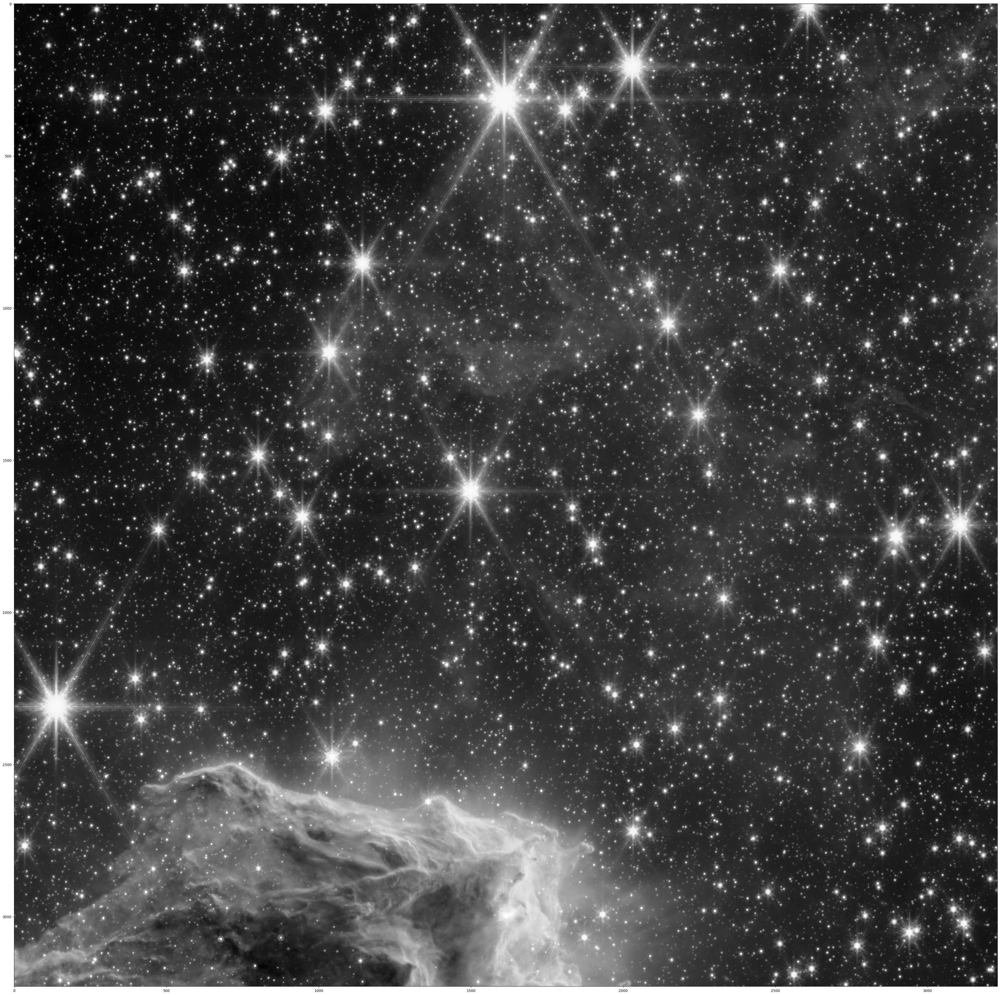

In [8]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
np.shape(gray)
plt.figure(figsize = (50,50))
plt.imshow(gray,cmap='gray')

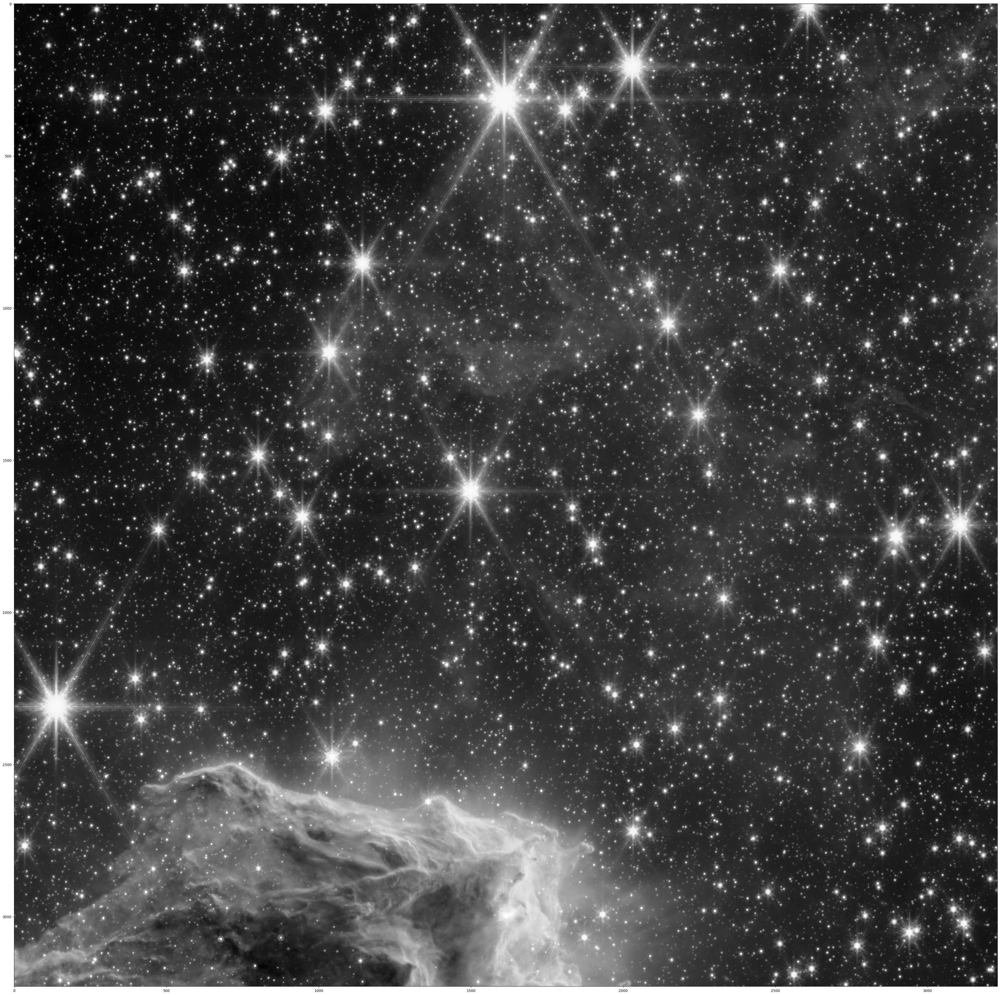

In [9]:
# using median method to filter
filtered = cv2.medianBlur(gray, 1)
np.shape(filtered)
plt.figure(figsize = (50,50))
plt.imshow(filtered,cmap = plt.cm.gray)

In [10]:
binary, threshold = cv2.threshold(filtered, 100, 255, cv2.THRESH_BINARY + cv2.THRESH_BINARY + cv2.THRESH_OTSU)
print(f"threshold is: {threshold}\n\nbinary is: {binary}\n\n")

threshold is: [[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [255 255 255 ...   0   0   0]
 [255 255 255 ...   0   0   0]
 [255 255 255 ...   0   0   0]]

binary is: 96.0




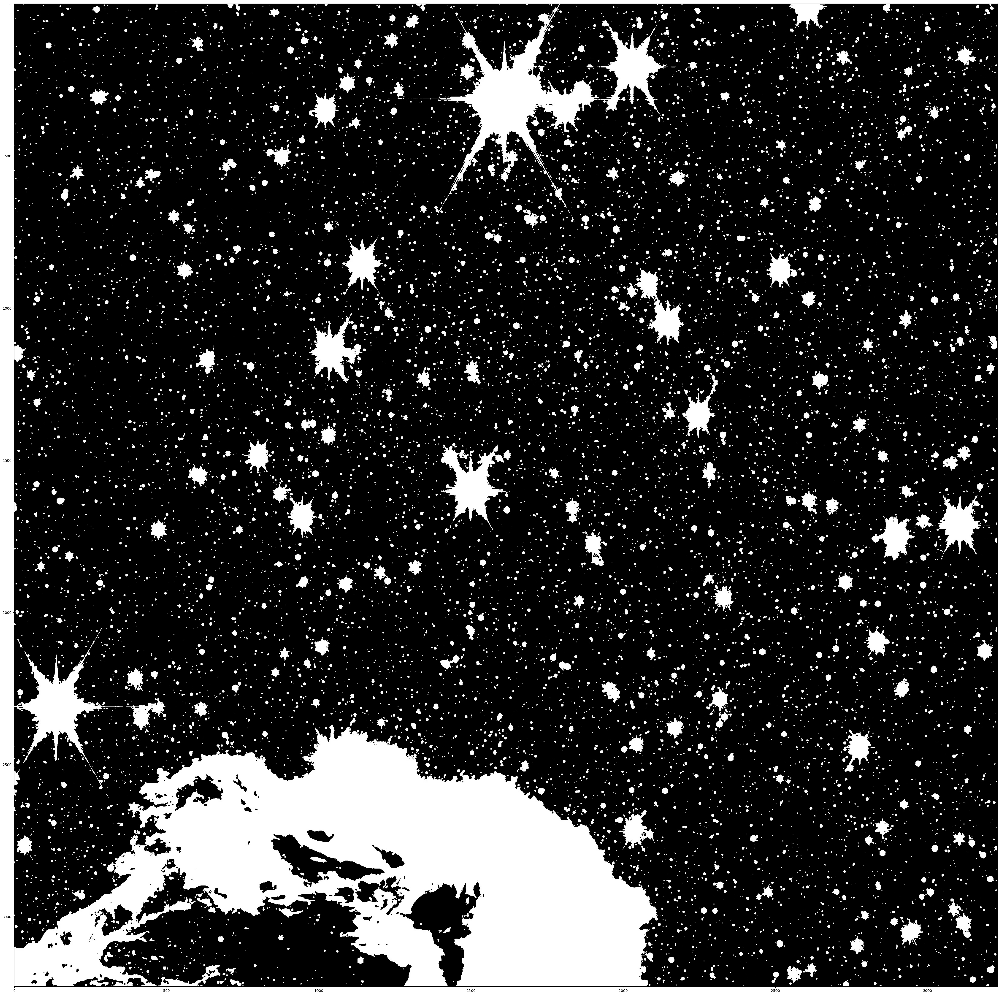

In [11]:
cv2.imwrite('processed_image.jpg', threshold)
img = cv2.imread("processed_image.jpg")
plt.figure(figsize = (50,50))
plt.imshow(img)

In [12]:
num_of_stars = np.count_nonzero(threshold)
print(f"number of stars: {num_of_stars}")

number of stars: 1687719


In [13]:
print(f"shape of img: {np.shape(img)}")

shape of img: (3230, 3230, 3)


# For-loop for Counting
This `for`-loop goes over all the pixels to count the number of stars, given that their center has an intensity above the threshold. Meanwhile, the coordinates of the stars will be added to a list for further analysis.

In [14]:
x, y = np.shape(img)[0], np.shape(img)[1]
num_circ = 0
coordinates_list = []
for i in range(x):
    for j in range(y):
        if (threshold[i][j] > 254):
            cv2.circle(img, (i, j), 1, (255, 0, 0))
            num_circ += 1
            coordinates_list.append((i, j))

shape of circ_img is: (3230, 3230, 3) and there are 1687719 circles in total


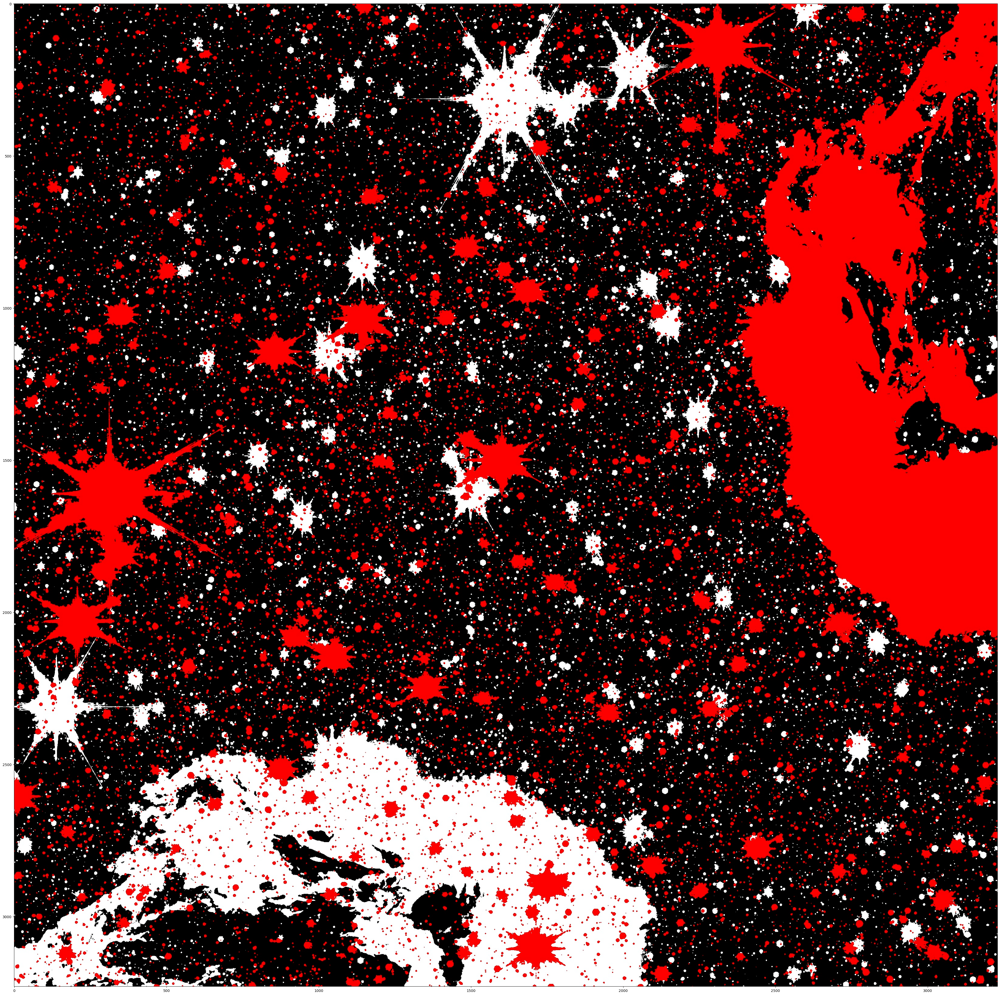

In [15]:
cv2.imwrite("colorful_pillars_circles.jpg", img)
circ_img = cv2.imread("colorful_pillars_circles.jpg")
print(f"shape of circ_img is: {np.shape(circ_img)} and there are {num_circ} circles in total")
plt.figure(figsize = (50,50))
plt.imshow(circ_img)